In [9]:
import pandas as pd
import numpy as np
import json
from tqdm import tqdm
from collections import Counter

# Data Loading & Cleaning

I downloaded my data from [kaggle](https://www.kaggle.com/datasets/Cornell-University/arxiv/data) but the below command can also be run to get the same data.

In [ ]:
! pip install kaggle
! kaggle datasets download -d Cornell-University/arxiv
! unzip arxiv.zip

In [ ]:
# Exploring format of JSON (as it's too big to open normally)
with open('arxiv-metadata-oai-snapshot.json', 'r') as f:
    print(f.readline())
    print(f.readline())
    print(f.readline())
    print(f.readline())
    print(f.readline())

In [10]:
# Get total lines in JSON file
with open('arxiv-metadata-oai-snapshot.json', 'r') as file:
    total_lines = sum(1 for _ in file)

max_lines = 10000
total_lines = max_lines if max_lines < total_lines else total_lines

arr = np.empty(total_lines, dtype=object)

# Iteratively process JSON into a dataframe
with open('arxiv-metadata-oai-snapshot.json', 'r') as file:
    for i, line in enumerate(tqdm(file, total=total_lines, desc="Processing lines")):
        if i < total_lines:
            json_obj = json.loads(line)
            # Only process the 'abstract' column (SUPER slow if we do the whole thing)
            if 'abstract' in json_obj:
                arr[i] = json_obj['abstract'].replace("\n", " ")

Processing lines: 2601564it [00:02, 1096291.42it/s]        


In [11]:
arr

array(['  A fully differential calculation in perturbative quantum chromodynamics is presented for the production of massive photon pairs at hadron colliders. All next-to-leading order perturbative contributions from quark-antiquark, gluon-(anti)quark, and gluon-gluon subprocesses are included, as well as all-orders resummation of initial-state gluon radiation valid at next-to-next-to-leading logarithmic accuracy. The region of phase space is specified in which the calculation is most reliable. Good agreement is demonstrated with data from the Fermilab Tevatron, and predictions are made for more detailed tests with CDF and DO data. Predictions are shown for distributions of diphoton pairs produced at the energy of the Large Hadron Collider (LHC). Distributions of the diphoton pairs from the decay of a Higgs boson are contrasted with those produced from QCD processes at the LHC, showing that enhanced sensitivity to the signal can be obtained with judicious selection of events. ',
      

In [12]:
len(arr)

10000

Now our data is cleaned we can push it to GitHub for easy access. You can load in the data as `arr` as an alternative to weilding the super big original.

In [13]:
pd.DataFrame(arr).to_csv('abstracts.csv', index=False, header=False)

Extract words & phrases from text data

In [14]:
tokenized_sentences = []
for txt in tqdm(arr, total=total_lines, desc="Processing tokens"):
    # Tokenize and lowercase
    if txt:
        tokens = txt.lower().split()

        # Handle strings of words (length of 1, 2, 3, 4)
        for window_len in range(0,5):
            for i in range(len(tokens) - window_len + 1):
                left = i
                right = i + window_len
                string = " ".join(tokens[left:right])
                tokens.append(string)

    tokenized_sentences.append(tokens)

Processing tokens: 100%|██████████| 10000/10000 [00:08<00:00, 1144.80it/s]


In [15]:
tokenized_sentences

[['a',
  'fully',
  'differential',
  'calculation',
  'in',
  'perturbative',
  'quantum',
  'chromodynamics',
  'is',
  'presented',
  'for',
  'the',
  'production',
  'of',
  'massive',
  'photon',
  'pairs',
  'at',
  'hadron',
  'colliders.',
  'all',
  'next-to-leading',
  'order',
  'perturbative',
  'contributions',
  'from',
  'quark-antiquark,',
  'gluon-(anti)quark,',
  'and',
  'gluon-gluon',
  'subprocesses',
  'are',
  'included,',
  'as',
  'well',
  'as',
  'all-orders',
  'resummation',
  'of',
  'initial-state',
  'gluon',
  'radiation',
  'valid',
  'at',
  'next-to-next-to-leading',
  'logarithmic',
  'accuracy.',
  'the',
  'region',
  'of',
  'phase',
  'space',
  'is',
  'specified',
  'in',
  'which',
  'the',
  'calculation',
  'is',
  'most',
  'reliable.',
  'good',
  'agreement',
  'is',
  'demonstrated',
  'with',
  'data',
  'from',
  'the',
  'fermilab',
  'tevatron,',
  'and',
  'predictions',
  'are',
  'made',
  'for',
  'more',
  'detailed',
  'tests

In [16]:
# Train model
from gensim.models import Word2Vec

word2vec_model = Word2Vec(sentences=tokenized_sentences, 
                          min_count=50, # Setting so at minimum each word will appear 50 times (helpful for training)
                          vector_size=1000, 
                          window=5)

In [17]:
# Get word embeddings
word_vectors = word2vec_model.wv
words = word_vectors.index_to_key
embeddings = np.array([word_vectors[word] for word in words])
embeddings

array([[-0.8546841 ,  0.2271595 , -0.7467882 , ..., -0.06323958,
        -0.9571633 , -1.1261467 ],
       [-0.93412757,  0.66071475, -0.15081188, ..., -0.51110613,
         0.798361  ,  1.2711911 ],
       [-0.69172156,  0.42764962, -0.45000234, ..., -1.6959018 ,
        -0.60833484, -0.26922426],
       ...,
       [ 0.08940211,  0.01100537,  0.1566875 , ...,  0.05378771,
         0.00834681,  0.05159498],
       [ 0.03136074, -0.07977124,  0.01778762, ...,  0.13604991,
         0.05062845, -0.02542364],
       [ 0.01831954,  0.04617241,  0.04051438, ...,  0.03635348,
        -0.11673505, -0.0858838 ]], dtype=float32)

In [18]:
len(embeddings)

11355

## K-Means Model

In [19]:
from copy import deepcopy

class KMeans:
    def __init__(self, k=None, tolerance=1e-4):
        self.k = k
        self.tolerance = tolerance
        self.centroids = {}
        self.classes = {}
        self.inertia_ = None

    def euclidean(self, point1, point2):
        return np.sqrt(np.sum((point1 - point2) ** 2))

    def predict(self, point):
        '''
        Predicts the closest cluster for a single data point
        '''
        distances = [self.euclidean(point, self.centroids[centroid]) for centroid in self.centroids]
        classification = distances.index(min(distances))
        return classification

    def fit(self, arr):
        '''
        Fits k-means clusters to the data

        Args:
            :arr: Array (np.array) - an array containing all data to be fit to k-means
        '''
        # Randomly initialize k number of centroids
        random_indices = np.random.choice(arr.shape[0], self.k, replace=False)
        for i, idx in enumerate(random_indices):
            self.centroids[i] = arr[idx]

        isOptimal = False

        while not isOptimal:
            # Create a dictionary to hold points for each cluster
            self.classes = {j: [] for j in range(self.k)}
            
            # Assign each data point to the nearest centroid
            for point in arr:
                distances = [self.euclidean(point, self.centroids[index]) for index in range(self.k)]
                cluster_index = distances.index(min(distances))
                self.classes[cluster_index].append(point)

            prev = deepcopy(self.centroids)

            # Reassign the centroid of each cluster as the mean of its points
            for cluster_index in self.classes:
                if len(self.classes[cluster_index]) > 0:
                    self.centroids[cluster_index] = np.mean(self.classes[cluster_index], axis=0)
                else:
                    # If a cluster ended up empty, reassign the centroid randomly
                    self.centroids[cluster_index] = arr[np.random.choice(arr.shape[0])]

            # Check if the centroids have moved
            isOptimal = True
            for centroid in self.centroids:
                og_centroid = prev[centroid]
                curr = self.centroids[centroid]
                # Check centroid movement via euclidean distance
                if self.euclidean(curr, og_centroid) > self.tolerance:
                    isOptimal = False
                    break

            if isOptimal:
                # If centroids stayed the same, we've converged
                break

        # Compute inertia once converged (for WCSS)
        self.inertia_ = 0
        for c in self.classes:
            for point in self.classes[c]:
                # squared distance from point to its centroid
                dist = self.euclidean(point, self.centroids[c])
                self.inertia_ += dist**2

In [14]:
# Test the best k value for clustering
import matplotlib.pyplot as plt

WCSS=[]
for i in tqdm(range(1, 250, 50), total=250/50, desc="Tuning k hyperparameter"):
  clf=KMeans(k=i)
  clf.fit(embeddings)
  WCSS.append(clf.inertia_)
WCSS

Tuning k hyperparameter: 100%|██████████| 5/5.0 [25:50<00:00, 310.16s/it]


[235693.14858461946,
 102894.46009750728,
 89925.00220101398,
 80665.64128236852,
 74088.42022427569]

Text(0, 0.5, 'WCSS Score')

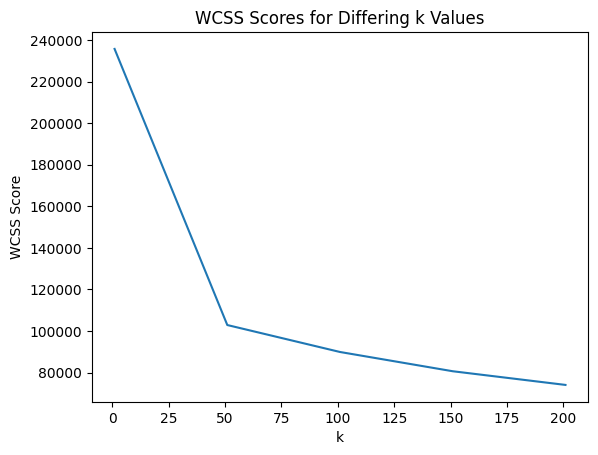

In [15]:
plt.plot(range(1,250, 50), WCSS)
plt.title("WCSS Scores for Differing k Values")
plt.xlabel("k")
plt.ylabel("WCSS Score")

A KMeans of ~50 is FAR too small so we reject this. There are much more than 40 ideas in 10K paper abstracts. We need a value in the thousands.

In [20]:
np.random.seed(0)
clf = KMeans(k=3000) # Arbitrarily setting k to 3000 for the sake of simplicity then evaluating and refining later
clf.fit(embeddings)

In [21]:
clf.predict(embeddings)

2416

In [22]:
len(embeddings)

11355

# EDA

In [23]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000)
reduced_embeddings = tsne.fit_transform(embeddings)

# Create a DataFrame with reduced dimensions and corresponding words
embedding_df = pd.DataFrame(reduced_embeddings, columns=['dim1', 'dim2'])
embedding_df['word'] = words
for i in range(len(embeddings)):
    embedding_df.loc[i, 'class'] = clf.predict(embeddings[i])
embedding_df

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


,dim1,dim2,word,class
0,-71.765381,12.020177,,2090.0
1,74.699181,-10.999669,,2695.0
2,48.046574,54.584221,,1603.0
3,-35.888119,73.204231,,806.0
4,21.499922,38.052536,,2844.0
...,...,...,...,...
11350,-47.901726,62.408199,"this paper, paper, we we present",2487.0
11351,-13.035889,56.668343,"paper, we present",1207.0
11352,41.562023,18.000593,the systematic,232.0
11353,-50.282494,-19.795000,programs,2416.0


In [24]:
import plotly.express as px

fig = px.scatter(embedding_df, x='dim1', y='dim2', color='class', hover_data={'word': True}, title="t-SNE Visualization of Word2Vec Embeddings", width=900, height=600)

fig.update_traces(textposition='top center')
fig.update_layout(title_font_size=20, xaxis_title="t-SNE Dimension 1", yaxis_title="t-SNE Dimension 2")

fig.show()

It worked, our ideas are now clustered in a way that makes sense semantically.

NOTE: Since this is a 2D PROJECTION of our 1000-dimensional vector space, not all clusters will be neatly arranged together but they are in the hyperdimensional space which is what matters.

# 

In [21]:
embedding_df.head()

,dim1,dim2,word,class
0,-63.568165,-7.759305,,2090.0
1,36.311024,58.427181,,550.0
2,-7.471416,-85.099930,,1603.0
3,-23.679840,-68.857536,,806.0
4,-14.441782,-62.752110,,2304.0


# N-Gram Model

Add 'END' to end of each sentence so model knows when to stop generating (train off class IDs and 'END')


In [28]:
class NGram:
    '''
        Maps each class ID to a frequency matrix of each class appearing next. Then uses that
        frequency matrix to probabilistically generate the next token once given starter text
        (user prompt).
    '''

    def __init__(self):
        self.next_classes = {}
        self.next_classes_freq = {}
        self.n = None
        self.word_to_class = {}
        self.class_to_words = {}

    def init_dicts(self, df):
        # Map words to their respective classes
        word_to_class = dict(zip(df['word'], df['class']))

        # Map classes to possible words for later generation
        self.word_to_class = word_to_class
        for i in df.index:
            word, classID = df['word'].iloc[i], df['class'].iloc[i]
            if classID not in self.class_to_words.keys():
                self.class_to_words[classID] = []
            self.class_to_words[classID].append(word)
        return word_to_class

    def initial_tokenize(self, txt):
        """
        Tokenize into the largest possible recognized tokens
        This method does NOT ensure n subtokens. It just returns what it can find.
        """
        words = txt.lower().split()
        tokens = []
        i = 0
        while i < len(words):
            matched = False
            for token_len in range(self.n, 0, -1):
                candidate = " ".join(words[i:i+token_len])
                if candidate in self.word_to_class:
                    tokens.append(candidate)
                    i += token_len
                    matched = True
                    break
            if not matched:
                # Move forward if no match found at this position
                i += 1
        return tokens

    def split_tokens(self, tokens):
        """
        If we have fewer than n tokens, try to split larger tokens into smaller ones.
        """
        # Continue until we have enough tokens or can't split any further
        while len(tokens) < self.n:
            split_performed = False

            for idx, t in enumerate(tokens):
                # Consider only multi-word tokens
                t_words = t.split()
                if len(t_words) > 1:
                    new_subtokens = self.initial_tokenize(t)

                    # Retoken each word if re-tokenizing yields the exact same single token as before
                    if len(new_subtokens) == 1 and new_subtokens[0] == t:
                        forced_subtokens = []
                        for w in t_words:
                            if w in self.word_to_class:
                                forced_subtokens.append(w)
                            else:
                                # Skip the word if not found
                                pass
                        if len(forced_subtokens) > 1:
                            new_subtokens = forced_subtokens

                    # If that resulted in more than one token, the split was successful
                    if len(new_subtokens) > 1:
                        tokens = tokens[:idx] + new_subtokens + tokens[idx+1:]
                        split_performed = True
                        break

            if not split_performed:
                break

        return tokens

    def tokenize(self, txt):
        """
        Attempts to return at least ngram.n tokens by splitting larger tokens if needed.
        """
        # Tokenize then split tokens and retokenize if the token tuple is less than n in length
        tokens = self.initial_tokenize(txt)
        tokens = self.split_tokens(tokens)

        # Trim to the correct size if too large
        if len(tokens) > self.n:
            tokens = tokens[-self.n:]

        # Convert to class IDs
        print(tokens)
        tokens = [self.word_to_class[t] for t in tokens]

        return tuple(tokens)
    

    def fit(self, text_arr, df, n=1):
        '''
        Fit the n-gram to the data and initalize all instance variables
        '''
        self.n = n
        # Map words to respective classes and classes to possible words
        word_to_class = self.init_dicts(df)

        # Get sequence of class IDs for each abstract
        class_sequence = []
        for abstract in text_arr:
            abstract_class_sequence = [word_to_class[word] for word in abstract.split() if abstract and word in word_to_class.keys()]
            # Adding stop token
            abstract_class_sequence += ['END'] * (n - 1)
            class_sequence += abstract_class_sequence

        # Identify unique classes
        unique_classes = list(set(class_sequence)) + ['END']
        n_classes = len(unique_classes)

        # Populate each n-gram with frequency matrix of next classes
        for i in range(len(class_sequence) - (n - 1)):
            sliding_token_window = tuple(class_sequence[i : i + n])

            # Initalize frequency matrix if n-gram is new
            if sliding_token_window not in self.next_classes.keys():
                self.next_classes[sliding_token_window] = np.zeros(n_classes)
            if sliding_token_window not in self.next_classes_freq:
                self.next_classes_freq[sliding_token_window] = np.zeros(n_classes)

            # Check if next class in sequence & set next class to 'END' if not
            next_class_seq_idx = i + n
            if next_class_seq_idx < len(class_sequence):
                next_class = class_sequence[next_class_seq_idx]
            else:
                next_class = 'END'

            # Increment frequency
            next_class_attr_idx = unique_classes.index(next_class)
            self.next_classes[sliding_token_window][next_class_attr_idx] += 1
            self.next_classes_freq[sliding_token_window][next_class_attr_idx] += 1

        # Convert numeric frequencies into expanded lists of class IDs
        for key, freq_array in self.next_classes_freq.items():
            updated_freqs = []
            for idx, freq in enumerate(freq_array):
                if freq != 0:
                    classID = unique_classes[idx]
                    updated_freqs += [classID] * int(freq)
            self.next_classes[key] = updated_freqs


    def generate(self, prompt = "", temperature_0 = False) -> str:
        '''
        Generates a response based on a user prompt. Only the last n tokens of the prompt will be considered.
        '''
        if not prompt:
            return
        if len(prompt.split()) < self.n:
            raise ValueError(f"Prompt must be at least {self.n} words in length.")

        # Tokenize inputs
        input_token = self.tokenize(prompt)

        # Generate
        output = []
        # Ensure input token has been seen in training data (and can be predicted with)
        try:
            if temperature_0:
                prediction, _ = Counter(self.next_classes[input_token]).most_common(1)[0]
            else:
                prediction = np.random.choice(self.next_classes[input_token])
        except:
            raise ValueError(f"Token {input_token} not in key. The model has not been trained off this data.")
        while prediction != 'END':
            output.append(np.float64(prediction))
            print(self.class_to_words[np.float64(prediction)])
            # Update input token
            input_token = input_token[1:] + (np.float64(prediction),)
            # Ensure input token has been seen in training data (and can be predicted with)
            try:
                if temperature_0:
                    prediction, _ = Counter(self.next_classes[input_token]).most_common(1)[0]
                else:
                    prediction = np.random.choice(self.next_classes[input_token])
            except:
                raise ValueError(f"Token {input_token} not in key. The model has not been trained off this data.")
        
        return output


    def fit_generate(self, text_arr, df, prompt = "", temperature_0 = False):
        '''
        Fits the model with n initialized to be the number of words in the prompt, then 
        generates a response accordingly. This method will take all the entire prompt into 
        account for generation.
        '''
        self.fit(text_arr, df, n=len(prompt.split()))
        return self.generate(prompt, temperature_0)

In [29]:
cleaned_arr = [abstract for abstract in arr if abstract is not None]

The data is sparse for an n-gram model so many n-gram/token combinations are not in the training set, resulting in errors with high values of n. Low values of n often result in infinite cyclical generations as a result of short context window. 

When the right combination is given the model works great, just needs more data and computational resources (i.e. disk space & compute) to be reliable.

## Evaluations

### N-Gram Evals

In [ ]:
# Initalizing n-grams with different n
np.random.seed(0)

ngram2 = NGram()
ngram2.fit(cleaned_arr, embedding_df, n=2)

ngram3 = NGram()
ngram3.fit(cleaned_arr, embedding_df, n=3)

ngram4 = NGram()
ngram4.fit(cleaned_arr, embedding_df, n=4)

ngram5 = NGram()
ngram5.fit(cleaned_arr, embedding_df, n=5)

ngram6 = NGram()
ngram6.fit(cleaned_arr, embedding_df, n=6)

ngram7 = NGram()
ngram7.fit(cleaned_arr, embedding_df, n=7)

In [47]:
ngram2.generate("In this paper we will explore", temperature_0=False)

['will', 'explore']
['classical', 'physical', 'dynamical', 'fundamental', 'special', 'statistical', 'geometric', 'basic', 'common']
['of', 'in', 'to']
['mid-infrared', 'spectra,', 'xmm-newton', 'follow-up', 'measurements,', 'archival', 'submillimeter', 'sed', 'irac', 'eso']
['and', 'or', 'than', 'when', 'but', 'while']
['maser', 'sio']
['emission', 'line', 'lines']
['and', 'or', 'than', 'when', 'but', 'while']
['absorption', 'agn', 'activity', 'co', 'fe']
['of', 'in', 'to']
['the', 'a', 'this', 'an']
['single']
['noise', 'bulk', 'mode', 'pressure', 'resonance', 'gap', 'instability', 'state,', 'disorder']
['regime', 'case,', 'time.', 'case.', 'limit,']
['main', 'us', 'further', 'future']
['is', 'are']
['of', 'in', 'to']
['also', 'if', 'very', 'then', 'about', 'thus']
['any', 'every']
['deformation', 'ideal', 'analogue']
['is', 'are']
['only', 'small', 'even', 'either', 'stable']
['new', 'used', 'possible']
['for', 'between']
['studying', 'measuring', 'calculating', 'constructing', 'esti

[1688.0,
 1116.0,
 622.0,
 379.0,
 2292.0,
 1067.0,
 379.0,
 1417.0,
 1116.0,
 285.0,
 2606.0,
 352.0,
 2101.0,
 343.0,
 2374.0,
 1116.0,
 460.0,
 2216.0,
 1342.0,
 2374.0,
 2120.0,
 1394.0,
 2713.0,
 446.0,
 2919.0,
 784.0,
 1116.0,
 2595.0,
 2374.0,
 54.0,
 2374.0]

This output with a relatively low n parameter is very repetitive and incoherent in many areas. It does not have a long enough context window to support complex and logical flows of thought.

In [43]:
np.random.seed(0)
ngram5.generate("In this paper we will explore", temperature_0=False)

['this', 'paper', 'we', 'will', 'explore']
['the', 'a', 'this', 'an', 'the', 'a', 'this', 'an']
['underlying', 'mathematical', 'elementary', 'geometrical', 'underlying', 'mathematical', 'elementary', 'geometrical']
['of', 'in', 'to', 'of', 'in', 'to']
['two', 'two']
['position', 'position']
['one', 'each', 'one', 'each']
['being', 'variable', 'object', 'orbit', 'being', 'variable', 'object', 'orbit']
['the', 'a', 'this', 'an', 'the', 'a', 'this', 'an']
['procedure', 'code', 'program', 'strategy', 'inequality', 'protocol', 'advantage', 'procedure', 'code', 'program', 'strategy', 'inequality', 'protocol', 'advantage']
['that', 'that']
['is', 'are', 'is', 'are']
['the', 'a', 'this', 'an', 'the', 'a', 'this', 'an']
['basis', 'definition', 'concept', 'computation', 'characterization', 'choice', 'kind', 'quantization', 'validity', 'realization', 'development', 'discussion', 'implementation', 'evaluation', 'basis', 'definition', 'concept', 'computation', 'characterization', 'choice', 'kind', 

[285.0,
 789.0,
 1116.0,
 804.0,
 2770.0,
 1020.0,
 102.0,
 285.0,
 1402.0,
 953.0,
 2374.0,
 285.0,
 2255.0,
 1116.0,
 1369.0,
 2517.0,
 482.0,
 804.0,
 1394.0,
 1020.0,
 2013.0,
 671.0,
 2762.0,
 2727.0,
 382.0,
 1116.0,
 285.0]

With some interpretation, this output is saying something to the effect of:

``
"In this paper, we will explore the underlying mathematical procedure in two positions, each acting as a variable. The procedure that is the basis of the concept will present two new ideas, each of which uses binary as part of this analysis."
``

This sounds like something that would be in a paper abstract, making intentions clear to leverage binary numbers to explore mathematical procedures for two variables. Although the output is missing context for which application the mathematical procedure is being explored, this seems interesting and not wildly incoherent.

In [67]:
# Using a very generic key
ngram7.generate("In this paper we will explore the", temperature_0=False)

['in', 'this', 'paper', 'we', 'will', 'explore', 'the']


ValueError: Token (1116.0, 285.0, 2181.0, 1369.0, 2517.0, 554.0, 285.0) not in key. The model has not been trained off this data.

When n is too high, even for common tokens like "In this paper we will explore the" does not exist in the training data. Scaling the training set will help with this given the computational resources to support it.

Overall, the optimal n for this model is between 3 and 5, striking a balance between high-quality generations and flexibility in valid prompting. This shows successes in the methods applied but demands further scaling in the future for top performance.

### Clustering Evals

We will analyze 100 randomly chosen class labels to evaluate using the Cohen's Kappa. Two annotators will be used and the agreeance scores recorded. 

If annotators agree that no words/phrases are out of place within a class, then they will Agree, otherwise they will Disagree with the observation, repeating for all 100 points.

In [36]:
np.random.seed(0)
ngram = NGram()
ngram.fit(cleaned_arr, embedding_df, n=1)

# Randomly choosing 100 classes
selection = np.random.choice(range(1, 3001), size=100, replace=False)
for classID in selection:
    print(f"{classID}\t{ngram.class_to_words[classID]}")

312	['insulating', 'accelerating', 'd-wave']
1026	['long as', 'as long']
1588	['a sufficient']
2942	['   in the', '   we discuss', '   it is', '   we construct']
2981	['sensitivity', 'radiative', 'probe', 'cmb']
2079	['the existence existence of of a', 'a wide wide range range of', 'good agreement agreement with with the', 'for the the case case of']
2282	['interpreted', 'expressed', 'solved', 'represented', 'treated', 'modeled']
721	['whole', 'planck', 'vanishes']
1538	['averaging', 'freely', 'secure', 'monte-carlo']
2494	['are based', 'on this', 'on their', 'on its', 'on these', 'on our']
1717	['canonical', 'path', 'generating', 'link', 'mapping']
537	['models with', 'that have', 'with different', 'which have', 'in its']
299	['are associated', 'be associated']
105	['associated to a']
1650	['sector.', 'pressure.', 'intracluster', 'emergent']
2300	['precession']
1110	['derivation of the', 'action of the']
900	['body', 'schwarzschild', 'extremal', 'kaluza-klein', 'kerr', 'wire', 'otherw

#### **Cohen's Kappa Results:**

Annotator 1, Annotator 2

Agree & Agree: 76

Agree & Disagree: 4

Disagree & Agree: 4

Disagree & Disagree: 16

**Cohen's Kappa Score**: 0.75